In [1]:
pip install fastai fastbook torch


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.8/719.8 kB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.2/7.2 MB 89.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 486.2/486.2 kB 40.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 74.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.5/110.5 kB 9.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.5/212.5 kB 14.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.3/134.3 kB 16.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 28.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 70.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 87.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 64.7 MB/s eta 0:00:00


In [2]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline
bs = 32  # batch size
version = 14

from fastai import *
from fastbook import *
from fastai.vision.all import *
from fastai.vision.widgets import *
from google.colab import drive

In [3]:
drive.mount('/content/drive')
%cd /content/drive/My Drive/Nut Recognizer

Mounted at /content/drive
/content/drive/My Drive/Nut Recognizer


In [4]:
nut_labels = [
    "raw Almonds",
    "raw Walnuts",
    "raw Cashew nut",
    "raw Pecans",
    "raw Peanut",
    "raw Pili nut",
    "raw Pistachios nut",
    "raw Hazelnuts",
    "raw Brazil nut",
    "raw Maccademia nut",
    "raw Pine nut",
    "raw Chestnut",
    "raw Hickory nut",
    "raw Ginkgo nut"
]
len(nut_labels)

label_to_idx = {label: idx for idx, label in enumerate(nut_labels)}

In [6]:
data_path = "data"
if not os.path.exists(data_path):
    os.mkdir(data_path)

for nut_type in nut_labels:
    dest = f"{data_path}/{nut_type}"
    if not os.path.exists(dest):
        os.mkdir(dest)
  #  try:
   #     nut_image_urls = search_images_ddg(nut_type)
   #     download_images(dest, urls=nut_image_urls)
  #  except:
   #     continue

In [ ]:
image_counts = get_image_files(data_path)
image_counts

failed = verify_images(image_counts)
failed

failed.map(Path.unlink)

In [8]:
dblock = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,                        # get_image_files returns a list of all images in that path recursively by default
    splitter=RandomSplitter(valid_pct=0.1, seed=42),  # getting 90-10 train-validation split
    get_y=parent_label,                               # taking the folder name as labels
    item_tfms=Resize(128))

# Enhanced Data Augmentation
#dblock = dblock.new(
    #item_tfms=Resize(224),                           # Resize images to a larger size
   # batch_tfms=aug_transforms(
    #    mult=2,                                      # Apply augmentation twice per image
    #    flip_vert=True,                              # Flip images vertically
     #   max_rotate=20.0,                              # Rotate images up to 20 degrees
     #   min_zoom=0.8, max_zoom=1.2,                   # Zoom in or out randomly
      #  pad_mode='zeros'                             # Pad images with zeros
  #  )
#)

In [9]:
dls = dblock.dataloaders(data_path,bs=bs)

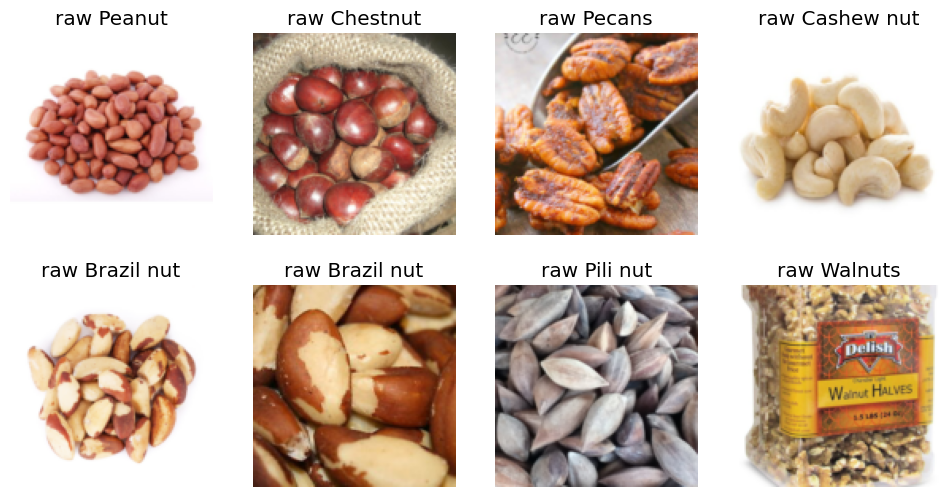

In [10]:
dls.train.show_batch(max_n=8, nrows=2)

###Data Augmentation

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


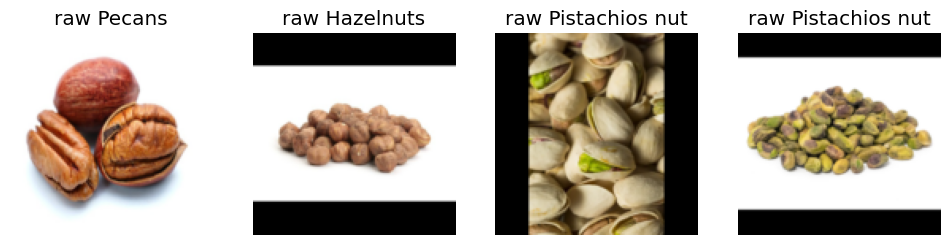

In [11]:
dblock = dblock.new(item_tfms=Resize(128, ResizeMethod.Pad, pad_mode='zeros')) # Padding the extra spaced the whole image into (128 x 128) size without squishing
dls = dblock.dataloaders(data_path)
dls.valid.show_batch(max_n=4, nrows=1)

In [12]:
# RandomResizedCrop crops images randomly and create copies so that we don't miss out anything
# aug_transforms is used for image data augmentation
dblock = dblock.new(item_tfms=RandomResizedCrop(224, min_scale=0.5), batch_tfms=aug_transforms())
dls = dblock.dataloaders(data_path)

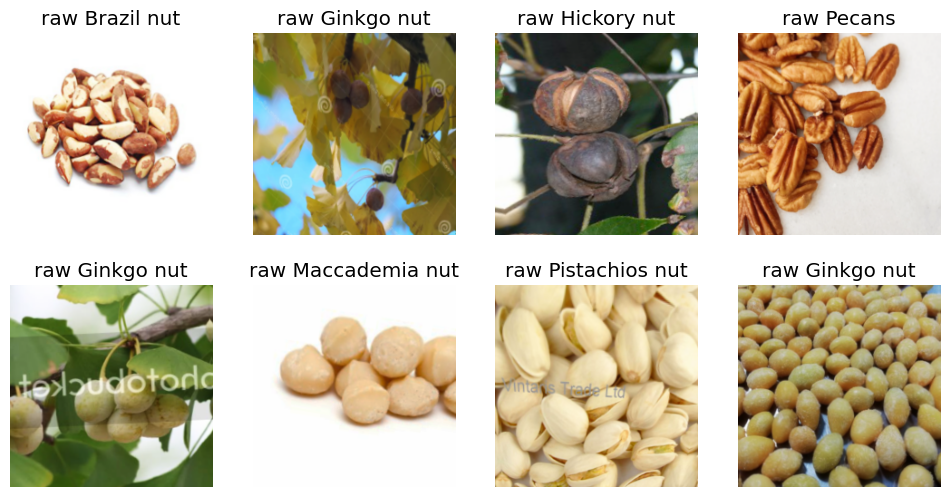

In [13]:
dls.train.show_batch(max_n=8, nrows=2)

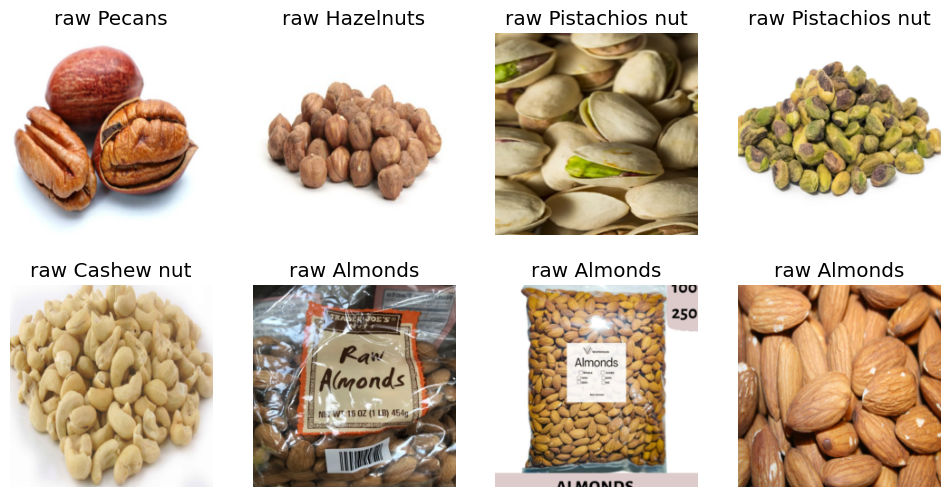

In [14]:
dls.valid.show_batch(max_n=8, nrows=2)

In [15]:
torch.save(dls, f"dataloaders/nut_dataloader_v{version}.pkl")  ## end of data preparation


In [5]:
dls = torch.load(f"dataloaders/nut_dataloader_v{version}.pkl")

In [6]:
dls.train.vocab

['raw Almonds', 'raw Brazil nut', 'raw Cashew nut', 'raw Chestnut', 'raw Ginkgo nut', 'raw Hazelnuts', 'raw Hickory nut', 'raw Maccademia nut', 'raw Peanut', 'raw Pecans', 'raw Pili nut', 'raw Pine nut', 'raw Pistachios nut', 'raw Walnuts']

###Training and data cleaning

In [17]:
model_path = "models"
# model = cnn_learner(dls, efficientnet_b2, metrics=[error_rate, accuracy])

model = vision_learner(dls, resnet34, metrics=[error_rate,accuracy])

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 414MB/s]


In [ ]:
# Transfer Learning with Discriminative Learning Rates and Gradual Unfreezing
#model.freeze()
#model.fit_one_cycle(4, slice(1e-3))

In [ ]:
#model.unfreeze()
#model.fit_one_cycle(6, slice(1e-6, 1e-4))

In [ ]:
 model.fine_tune(5)

In [ ]:
model.save(f"nut-recognizer-v{version}")

# model.load(f"nut-recognizer-v{version}")

Path('models/nut-recognizer-v14.pth')

In [ ]:
model.load(f"nut-recognizer-v{version}")

In [ ]:
model.fine_tune(5)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.308176,0.506940,0.181818,0.818182,01:06


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.265076,0.430014,0.138528,0.861472,01:08
1,0.316957,0.478426,0.147186,0.852814,01:09
2,0.293555,0.504703,0.151515,0.848485,01:08
3,0.233769,0.343186,0.116883,0.883117,01:10
4,0.186081,0.341543,0.095238,0.904762,01:07


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes sh

In [ ]:
model.save(f"nut-recognizer-v{version}")

Path('models/nut-recognizer-v14.pth')

In [ ]:
model.fine_tune(5)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.125449,0.344957,0.099567,0.900433,01:07


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.107540,0.338367,0.099567,0.900433,01:08
1,0.164425,0.673777,0.194805,0.805195,01:09
2,0.181056,0.493153,0.138528,0.861472,01:07
3,0.154936,0.402377,0.108225,0.891775,01:10
4,0.109118,0.404790,0.095238,0.904762,01:07


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes sh

In [ ]:
model.save(f"nut-recognizer-v{version}")

Path('models/nut-recognizer-v14.pth')

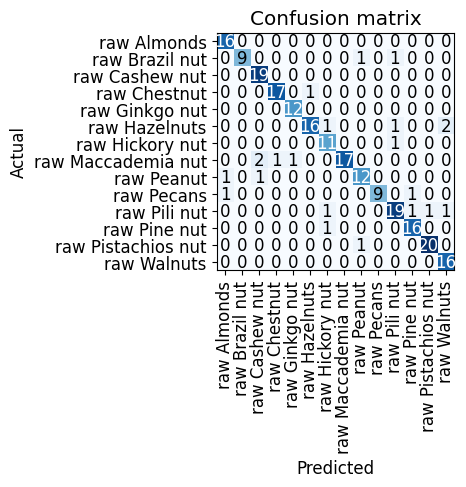

In [ ]:
interp = ClassificationInterpretation.from_learner(model)
interp.plot_confusion_matrix()

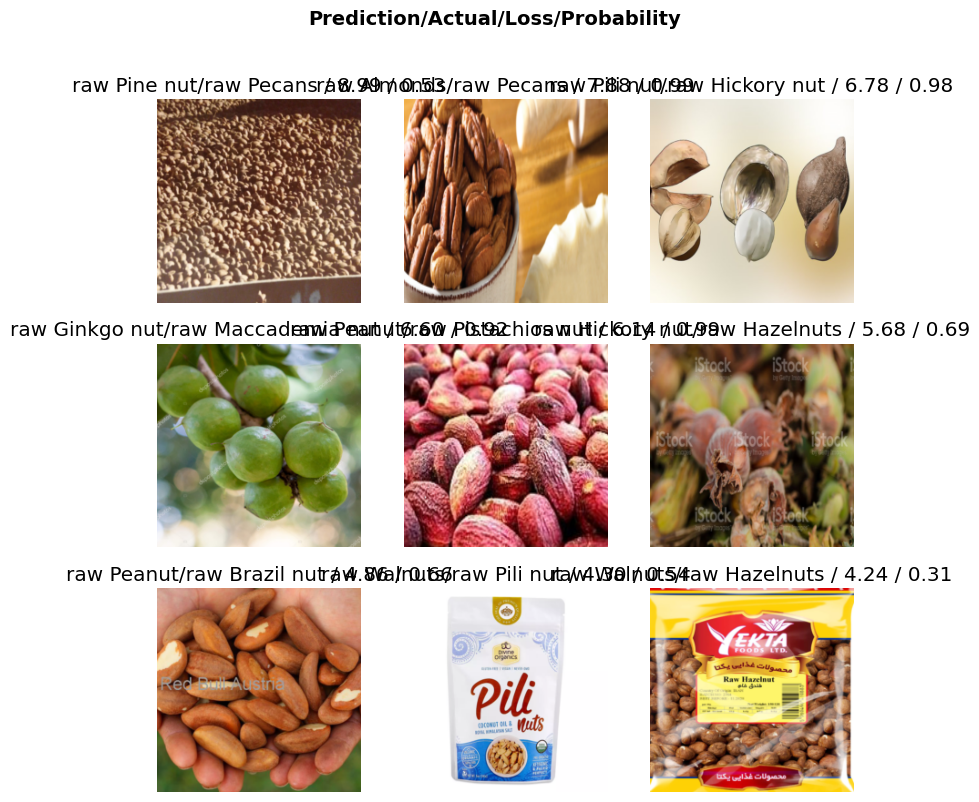

In [ ]:
interp.plot_top_losses(9, nrows=3)

In [ ]:
cleaner = ImageClassifierCleaner(model)
cleaner # peanuts, walnuts, macadamia nuts

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


In [ ]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()                                    # delete irrelevant data
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), f"{data_path}/{cat}") # change the directory

### Export model for inference

In [ ]:
model.export(f"{model_path}/nut-recognizer-v{version}.pkl")

Go to inference.pynb file for inference